<a href="https://colab.research.google.com/github/flyingfalling/eyemvmnt_phys_2024/blob/main/phys2024_tobiig3_vor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### (Setup Code)

In [ ]:
#Required installations of packages. This must be re-done each time? Very inconvenient.
#Note, install peyeutils here, with appropriate automatically-installed requirements.
#      This may include pip install of opencv itself (with ffmpeg).
#!pip install git+https://github.com/xioTechnologies/Fusion.git

In [ ]:
def anim_to_vid(ani, fname, fps=30):
  import matplotlib;
  Writer = matplotlib.animation.writers['ffmpeg']
  writer = Writer(fps=fps, metadata=dict(artist='Me'), bitrate=3600)
  ani.save(fname, writer = writer)
  return ani;

# Function to convert animation to video (replace with your actual implementation)
def anim_to_vid(ani, filename, fps=15):
    # This is a placeholder.  Replace this with actual code to save your animation.
    #  FFMpeg is needed for this.
    # The user needs to install it manually.
    Writer = animation.FFMpegWriter(fps=fps)
    ani.save(filename, writer=Writer)
    print(f"Animation saved as {filename}")  # Confirmation message
    return ani # Return the animation object

def upload_file_to_drive_get_URL(fname):
  !pip install -U kora
  from kora.drive import upload_public
  url = upload_public(fname)
  # then display it
  #from IPython.display import HTML
  #HTML(f"""<video src={url} width=500 controls/>""")
  print("Uploaded [{}] to {}".format(fname, url));
  return url;


FLU convention image

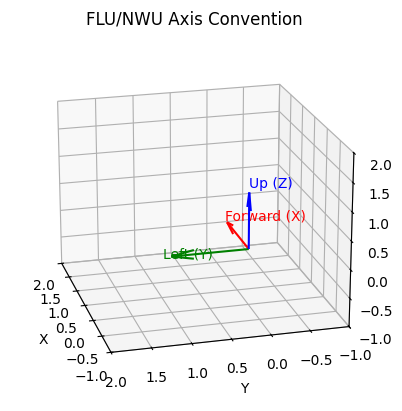

In [ ]:
# prompt: Plot a 3D graph showing the FLU (forward, left, up) axis convention. Put labels directly next to the colored arrows representing each of the primary positive axes. Show the graph from behind and slightly above and to the left.

import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

# Create a figure and an axes object for the 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define the origin and the vectors representing the axes
origin = [0, 0, 0]
x_axis = [1, 0, 0]
y_axis = [0, 1, 0]
z_axis = [0, 0, 1]

# Plot the axes with labels next to the arrows
ax.quiver(*origin, *x_axis, color='r', label='Forward (X)')
ax.text(1.1, 0, 0, 'Forward (X)', color='r')
ax.quiver(*origin, *y_axis, color='g', label='Left (Y)')
ax.text(0, 1.1, 0, 'Left (Y)', color='g')
ax.quiver(*origin, *z_axis, color='b', label='Up (Z)')
ax.text(0, 0, 1.1, 'Up (Z)', color='b')


# Set axis labels and limits
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.set_xlim([-1, 2])  # Extended x-limit to accommodate the label
ax.set_ylim([-1, 2])  # Extended y-limit to accommodate the label
ax.set_zlim([-1, 2])  # Extended z-limit to accommodate the label


# Set the viewing angle
ax.view_init(elev=20, azim=-195) # elev for vertical angle, azim for horizontal angle

flu_axis_convention_fname = 'flu_axis_convention.png';
plt.title("FLU/NWU Axis Convention")
fig.savefig(flu_axis_convention_fname)
# Display the plot
plt.show()


NWU convention image

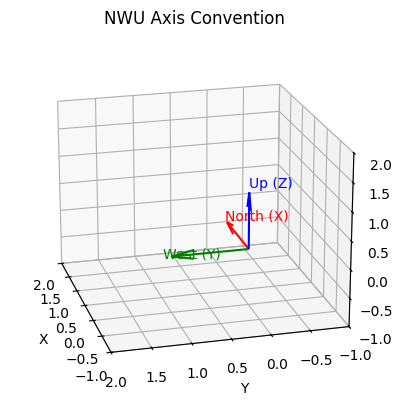

In [ ]:
# prompt: Do the same as the previous code but instead of forward left up, use north west up.

import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

# Create a figure and an axes object for the 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define the origin and the vectors representing the axes
origin = [0, 0, 0]
x_axis = [1, 0, 0]
y_axis = [0, 1, 0] # Changed for NWU convention
z_axis = [0, 0, 1]

# Plot the axes with labels next to the arrows
ax.quiver(*origin, *x_axis, color='r', label='North (X)')
ax.text(1.1, 0, 0, 'North (X)', color='r')
ax.quiver(*origin, *y_axis, color='g', label='West (Y)')
ax.text(0, 1.1, 0, 'West (Y)', color='g') # Adjusted text position
ax.quiver(*origin, *z_axis, color='b', label='Up (Z)')
ax.text(0, 0, 1.1, 'Up (Z)', color='b')


# Set axis labels and limits
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.set_xlim([-1, 2])  # Extended x-limit to accommodate the label
ax.set_ylim([-1, 2])  # Extended y-limit to accommodate the label, and changed range for NWU
ax.set_zlim([-1, 2])  # Extended z-limit to accommodate the label


# Set the viewing angle
ax.view_init(elev=20, azim=-195) # elev for vertical angle, azim for horizontal angle
nwu_axis_convention_fname = 'nwu_axis_convention.png';
fig.savefig(nwu_axis_convention_fname);
plt.title("NWU Axis Convention")
# Display the plot
plt.show()

Step-by-step rotation (45deg/45deg/25deg)

Animation saved as stepbystep_NWU_anim.mp4


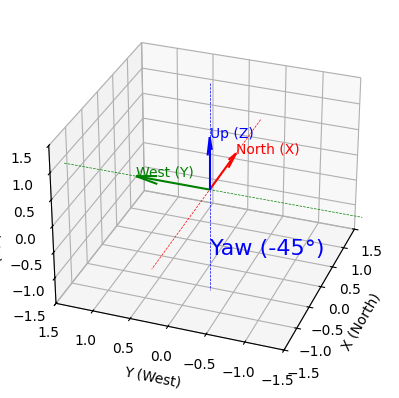

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.animation as animation;

# Function to generate rotation matrices
def rotation_matrix_yaw(angle):
    angle = np.radians(angle)
    return np.array([
        [np.cos(angle), -np.sin(angle), 0],
        [np.sin(angle), np.cos(angle), 0],
        [0, 0, 1]
    ])

def rotation_matrix_pitch(angle):
    angle = np.radians(angle)
    return np.array([
        [np.cos(angle), 0, np.sin(angle)],
        [0, 1, 0],
        [-np.sin(angle), 0, np.cos(angle)]
    ])

def rotation_matrix_roll(angle):
    angle = np.radians(angle)
    return np.array([
        [1, 0, 0],
        [0, np.cos(angle), -np.sin(angle)],
        [0, np.sin(angle), np.cos(angle)]
    ])

# NWU coordinate axes (North, West, Up)
def plot_arrows(ax, vectors, labels, colors):
    for vector, label, color in zip(vectors, labels, colors):
        ax.quiver(0, 0, 0, vector[0], vector[1], vector[2], color=color);
        ax.text(vector[0], vector[1], vector[2], label, color=color);
        pass;
    return;


# Set up the figure and 3D axes
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim([-1.5, 1.5])
ax.set_ylim([-1.5, 1.5])
ax.set_zlim([-1.5, 1.5])
ax.set_xlabel('X (North)')
ax.set_ylabel('Y (West)')
ax.set_zlabel('Z (Up)')
ax.view_init(elev=30, azim=200)  # View from behind and slightly above the negative North axis

# Initial arrow setup
original_vectors = np.eye(3)
colors = ['r', 'g', 'b']
labels = ['North (X)', 'West (Y)', 'Up (Z)']
annotations = ['Yaw (-45°)', 'Pitch (-45°)', 'Roll (25°)']
rotations = [rotation_matrix_yaw(-45), rotation_matrix_pitch(-45), rotation_matrix_roll(25)]

# Cumulative rotation matrix
cumulative_rotation = np.eye(3)



# Update function for animation
def update(frame):
    global cumulative_rotation
    if( frame==0 ):
      cumulative_rotation = np.eye(3);
    ax.cla()  # Clear the axes
    ax.set_xlim([-1.5, 1.5])
    ax.set_ylim([-1.5, 1.5])
    ax.set_zlim([-1.5, 1.5])
    ax.set_xlabel('X (North)')
    ax.set_ylabel('Y (West)')
    ax.set_zlabel('Z (Up)')
    ax.view_init(elev=30, azim=200)  # Maintain the desired view
    # Add thin dotted lines for full axis

    step = frame // 20  # Determine the current step (0 for yaw, 1 for pitch, 2 for roll)
    fraction = (frame % 20) / 20.0

    #print("Step: {} Fraction: {}".format(step, fraction));

    size=2;
    for vector, c in zip(original_vectors, colors):
        ax.plot([vector[0]*size, -vector[0]*size],
                [vector[1]*size, -vector[1]*size],
                [vector[2]*size, -vector[2]*size],
                '--',
                linewidth=0.5, color=c);

    if step < len(rotations):
        incremental_rotation = np.eye(3) + fraction * (rotations[step] - np.eye(3))
        rotated_vectors = cumulative_rotation @ incremental_rotation @ original_vectors.T
        plot_arrows(ax, rotated_vectors.T, labels, colors)
        ax.text(0, 0, -1.3, annotations[step], fontsize=16, color=colors[::-1][step])
        pass;



    if frame % 20 == 19 and step < len(rotations):
        cumulative_rotation = rotated_vectors;
        pass;

    pass

# Animate the plot
frames = 60  # Exactly one set of rotations (3 steps with 20 frames each)

#REV: every time I "run" it, state gets reset (in ani)
stepbystep_nwu_vid_fname='stepbystep_NWU_anim.mp4'
ani = FuncAnimation(fig, update, frames=frames, interval=100, repeat=False)  # Do not repeat
ani = anim_to_vid(ani, stepbystep_nwu_vid_fname, fps=15);

# Display the animation in Colab
HTML(ani.to_jshtml())



Single-shot rotation (45/45/25)

Animation saved as full_NWU_anim.mp4


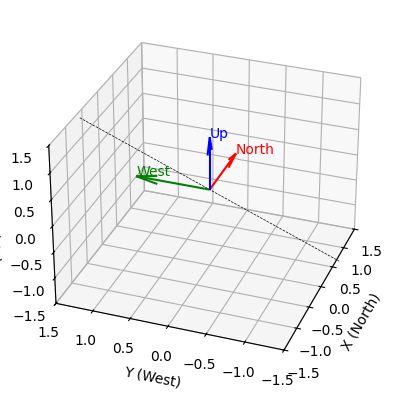

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.animation as animation;

# Define Euler angles (NWU convention)
euler_angles = np.array([25, -45, -45])  # Roll, Pitch, Yaw

def rotation_axis(R):
  """
  Calculates the axis of rotation from a rotation matrix.

  Args:
    R: A 3x3 rotation matrix.

  Returns:
    A numpy array representing the axis of rotation.
  """
  # Calculate the skew-symmetric matrix
  skew = (R - R.T)

  # Extract the axis of rotation from the skew-symmetric matrix
  axis = np.array([skew[2, 1], skew[0, 2], skew[1, 0]])

  # Normalize the axis
  axis = axis / np.linalg.norm(axis)
  return axis

# Function to generate rotation matrices
def rotation_matrix_x(angle):
    angle = np.radians(angle)
    return np.array([
        [1, 0, 0],
        [0, np.cos(angle), -np.sin(angle)],
        [0, np.sin(angle), np.cos(angle)]
    ])

def rotation_matrix_y(angle):
    angle = np.radians(angle)
    return np.array([
        [np.cos(angle), 0, np.sin(angle)],
        [0, 1, 0],
        [-np.sin(angle), 0, np.cos(angle)]
    ])

def rotation_matrix_z(angle):
    angle = np.radians(angle)
    return np.array([
        [np.cos(angle), -np.sin(angle), 0],
        [np.sin(angle), np.cos(angle), 0],
        [0, 0, 1]
    ])

# Calculate the overall rotation matrix
R_x = rotation_matrix_x(euler_angles[0])
R_y = rotation_matrix_y(euler_angles[1])
R_z = rotation_matrix_z(euler_angles[2])
R = R_z @ R_y @ R_x
axis = rotation_axis(R);

# Function to plot arrows
def plot_arrows(ax, vectors, labels, colors):
    for vector, label, color in zip(vectors, labels, colors):
        ax.quiver(0, 0, 0, vector[0], vector[1], vector[2], color=color)
        ax.text(vector[0], vector[1], vector[2], label, color=color)

# Set up the figure and axes
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim([-1.5, 1.5])
ax.set_ylim([-1.5, 1.5])
ax.set_zlim([-1.5, 1.5])
ax.set_xlabel('X (North)')
ax.set_ylabel('Y (West)')
ax.set_zlabel('Z (Up)')
ax.view_init(elev=30, azim=200)

# Initial and final vectors
initial_vectors = np.eye(3)
colors = ['r', 'g', 'b']
labels = ['North', 'West', 'Up']

# Animation update function
def update(frame):
    ax.cla()
    ax.set_xlim([-1.5, 1.5])
    ax.set_ylim([-1.5, 1.5])
    ax.set_zlim([-1.5, 1.5])
    ax.set_xlabel('X (North)')
    ax.set_ylabel('Y (West)')
    ax.set_zlabel('Z (Up)')
    ax.view_init(elev=30, azim=200)
    size=2;
    ax.plot([-axis[0]*size, axis[0]*size], [-axis[1]*size, axis[1]*size], [-axis[2]*size, axis[2]*size], '--', color='black', linewidth=0.5);

    fraction = frame / 50
    R_current = np.eye(3) + fraction * (R - np.eye(3))
    rotated_vectors = R_current @ initial_vectors.T
    plot_arrows(ax, rotated_vectors.T, labels, colors)
    return;


# Create the animation
ani = FuncAnimation(fig, update, frames=50, interval=50, repeat=False)
full_nwu_vid_fname='full_NWU_anim.mp4'
ani = anim_to_vid(ani, full_nwu_vid_fname, fps=15);
HTML(ani.to_jshtml())

Single heading vector video with angle trajectory (random data)


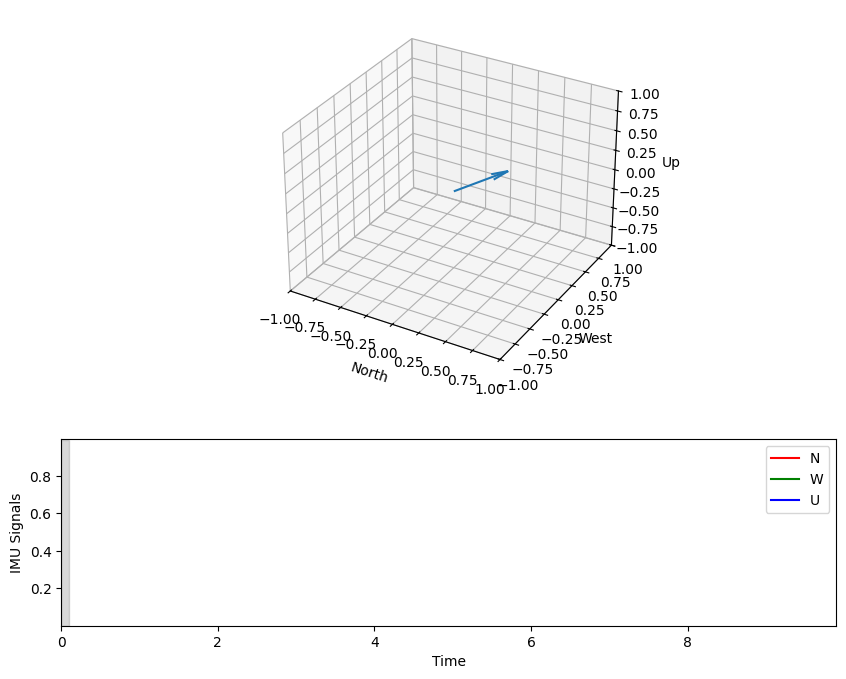

In [ ]:
# prompt: Write a function that animates a video in 3D a time series of IMU data. The top half of the animation should show the N, W, U arrows in 3D representing the current heading and the bottom should be a 2D plot showing the 3 IMU signals (N, W, U) plotted versus time in their corresponding colors.The bottom plot should have a moving band highlighting to the time currently being represented.

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

def animate_imu_data(imu_data, timestamps):
    """
    Animates IMU data in 3D with a 2D time-series plot.

    Args:
        imu_data: A NumPy array of shape (n_samples, 3) representing the IMU data (N, W, U).
        timestamps: A NumPy array of shape (n_samples,) representing the timestamps for each sample.
    """

    fig = plt.figure(figsize=(10, 8))
    gs = fig.add_gridspec(2, 1, height_ratios=[2, 1])

    ax1 = fig.add_subplot(gs[0], projection='3d')  # 3D plot for arrows
    ax2 = fig.add_subplot(gs[1])  # 2D plot for time-series data

    # Initial arrow plot
    line, = ax1.plot([], [], [], 'b-', lw=2)  # Initialize the arrow plot
    ax1.set_xlim([-1, 1])
    ax1.set_ylim([-1, 1])
    ax1.set_zlim([-1, 1])
    ax1.set_xlabel('North')
    ax1.set_ylabel('West')
    ax1.set_zlabel('Up')

    # Initial time-series plot
    lines = []
    for i in range(3):
      line, = ax2.plot([], [], '-', label=['N','W','U'][i], color=['r', 'g', 'b'][i])  # Initialize lines for time-series
      lines.append(line)
      pass;

    ax2.set_xlim(timestamps[0], timestamps[-1])
    ax2.set_ylim(np.min(imu_data), np.max(imu_data))
    ax2.set_xlabel('Time')
    ax2.set_ylabel('IMU Signals')
    ax2.legend()

    # Shade
    shade = ax2.axvspan(timestamps[0], timestamps[0], alpha=0.3, color='gray')

    def update(frame):
        # 3D Arrow
        ax1.cla() # Clear the previous frame
        n = imu_data[frame, 0]
        w = imu_data[frame, 1]
        u = imu_data[frame, 2]
        ax1.quiver(0, 0, 0, n, w, u, length=0.5, normalize=True)

        ax1.set_xlim([-1, 1])
        ax1.set_ylim([-1, 1])
        ax1.set_zlim([-1, 1])
        ax1.set_xlabel('North')
        ax1.set_ylabel('West')
        ax1.set_zlabel('Up')


        # Time-series plot
        for i in range(3):
          lines[i].set_data(timestamps[:frame+1], imu_data[:frame+1,i])

        #REV: matplotlib axvspan now returns rectangle
        #set_xy fuck this is rectangle, sets bottom-left. It is not a polygon, which sets vertices...
        left = timestamps[frame]
        right = timestamps[frame + 1] if frame < len(timestamps) - 1 else timestamps[frame];
        bot = ax2.get_ylim()[0]
        top = ax2.get_ylim()[1]

        if( type(shade) == plt.Polygon ):
            shade.set_xy([[left, bot],
                          [left, top],
                          [right, bot],
                          [right, top]]
                         )
        elif( type(shade) == plt.Rectangle ):
            shade.set_xy([left, bot]);
            shade.set_width(right-left);
            shade.set_height(top-bot)
            pass;
        else:
            raise Exception("Not recognized type {}".format(type(shade)));


        return line, *lines, shade

    ani = animation.FuncAnimation(fig, update, frames=len(imu_data), interval=50, repeat=False); #, blit=True)
    return ani

# Sample Usage: Replace this with your actual IMU data and timestamps
imu_data = np.random.rand(100, 3) # Example data - Replace with your actual IMU data
timestamps = np.arange(0, 10, 0.1) # Example timestamps - Replace with actual timestamps


ani = animate_imu_data(imu_data, timestamps)
from IPython.display import HTML
HTML(ani.to_jshtml())

45/45 Rotation (ignoring roll) with trajectory video and 3 axes arrows

In [ ]:
# prompt: Do the same thing, but have the IMU data be in the form of Tait-Bryan angles representing Roll, Pitch, and Yaw (X,Y,Z) using the NWU convention (labelled North, West, Up).  The 3D plot should have 3 arrows representing forward, left, and up. Compute the rotation matrix using Rodruiguez's formula, with convention of yaw-pitch-roll being applied in that order (intrinsic coordinates). For the example data use a smooth sine wave between -pi/2 and pi/2 and make it 100 timesteps long.

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

def rotation_matrix(roll, pitch, yaw):
    # Rotation matrices around x, y, and z axes
    Rx = np.array([[1, 0, 0],
                   [0, np.cos(roll), -np.sin(roll)],
                   [0, np.sin(roll), np.cos(roll)]])
    Ry = np.array([[np.cos(pitch), 0, np.sin(pitch)],
                   [0, 1, 0],
                   [-np.sin(pitch), 0, np.cos(pitch)]])
    Rz = np.array([[np.cos(yaw), -np.sin(yaw), 0],
                   [np.sin(yaw), np.cos(yaw), 0],
                   [0, 0, 1]])

    # Combined rotation matrix (Yaw-Pitch-Roll)
    R = Rz @ Ry @ Rx
    return R


def animate_imu_data3(imu_data, timestamps):
    '''imu_data in degrees. timestamps in seconds'''
    colors=['r', 'g', 'b'];
    fig = plt.figure(figsize=(10, 8))
    gs = fig.add_gridspec(2, 1, height_ratios=[2, 1])

    ax1 = fig.add_subplot(gs[0], projection='3d')
    ax2 = fig.add_subplot(gs[1])
    scale=1.5;
    # Initial arrow plot
    line, = ax1.plot([], [], [], 'b-', lw=2)
    ax1.set_xlim([-scale, scale])
    ax1.set_ylim([-scale, scale])
    ax1.set_zlim([-scale, scale])
    ax1.set_xlabel('North')
    ax1.set_ylabel('West')
    ax1.set_zlabel('Up')
    original_vectors = [[1,0,0], [0,1,0], [0,0,1]]; # N, W, UP
    size=2;

    ax1.view_init(elev=30, azim=200)

    # Initial time-series plot
    lines = []
    for i in range(3):
        line, = ax2.plot([], [], '-', label=['Roll', 'Pitch', 'Yaw'][i], color=colors[i])
        lines.append(line)
    ax2.set_xlim(timestamps[0], timestamps[-1])
    ax2.set_ylim(-180,180)
    ax2.set_xlabel('Time')
    ax2.set_ylabel('Angles (deg)')
    ax2.legend()

    shade = ax2.axvspan(timestamps[0], timestamps[0], alpha=0.3, color='gray');


    def update(frame):

        ax1.cla()
        roll, pitch, yaw = np.deg2rad(imu_data[frame, :])  # Assuming imu_data has roll, pitch, yaw
        R = rotation_matrix(roll, pitch, yaw)
        nwulabels=['North', 'West', 'Up']
        for i, (vector, c) in enumerate(zip(original_vectors, colors)):
          ax1.plot([vector[0]*scale, -vector[0]*scale],
                  [vector[1]*scale, -vector[1]*scale],
                  [vector[2]*scale, -vector[2]*scale],
                  '--',
                  linewidth=0.5, color=c);
          ax1.text(vector[0]*scale, vector[1]*scale, vector[2]*scale, nwulabels[i], color=colors[i]);
          pass;
        # Define vectors for forward, left, and up in the body frame
        forward = np.array([1, 0, 0])
        left = np.array([0, 1, 0])
        up = np.array([0, 0, 1])

        # Rotate the vectors to the NWU frame
        forward_nwu = R @ forward
        left_nwu = R @ left
        up_nwu = R @ up

        ax1.quiver(0, 0, 0, *forward_nwu, color=colors[0], label='Forward')
        ax1.text(*forward_nwu, 'Forward (X)', color=colors[0]);
        ax1.quiver(0, 0, 0, *left_nwu, color=colors[1], label='Left')
        ax1.text(*left_nwu, 'Left (Y)', color=colors[1]);
        ax1.quiver(0, 0, 0, *up_nwu, color=colors[2], label='Up')
        ax1.text(*up_nwu, 'Up (Z)', color=colors[2]);

        ax1.set_xlim([-scale, scale])
        ax1.set_ylim([-scale, scale])
        ax1.set_zlim([-scale, scale])
        ax1.set_xlabel('North')
        ax1.set_ylabel('West')
        ax1.set_zlabel('Up')
        #ax1.legend()

        for i in range(3):
            lines[i].set_data(timestamps[:frame + 1], imu_data[:frame + 1, i])
            pass;


        #REV: matplotlib axvspan now returns rectangle
        #set_xy fuck this is rectangle, sets bottom-left. It is not a polygon, which sets vertices...
        left = timestamps[frame]
        right = timestamps[frame + 1] if frame < len(timestamps) - 1 else timestamps[frame];
        bot = ax2.get_ylim()[0]
        top = ax2.get_ylim()[1]

        if( type(shade) == plt.Polygon ):
            shade.set_xy([[left, bot],
                          [left, top],
                          [right, bot],
                          [right, top]]
                         )
        elif( type(shade) == plt.Rectangle ):
            shade.set_xy([left, bot]);
            shade.set_width(right-left);
            shade.set_height(top-bot)
            pass;
        else:
            raise Exception("Not recognized type {}".format(type(shade)));

        return line, *lines, shade


    ani = animation.FuncAnimation(fig, update, frames=len(imu_data), interval=50, repeat=False); #, blit=True)
    return ani;

# Example Data (smooth sine waves)
timestamps = np.arange(0, 50, 1)
imu_data = np.zeros((len(timestamps), 3))
print(timestamps)
imu_data[0,:] = [0,0,0]
for i in range(1,len(timestamps)):
  imu_data[i,0] = imu_data[i-1,0] + 0
  if( i >= 25 ):
    imu_data[i,1] = imu_data[i-1,1] + 2
  else:
    imu_data[i,1] = imu_data[i-1,1] + 0
  if( i < 25):
    imu_data[i,2] = imu_data[i-1,2] + 2
  else:
    imu_data[i,2] = imu_data[i-1,2] + 0
  pass;

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49]


Animation saved as example_trajectory_vid.mp4


KeyboardInterrupt: 

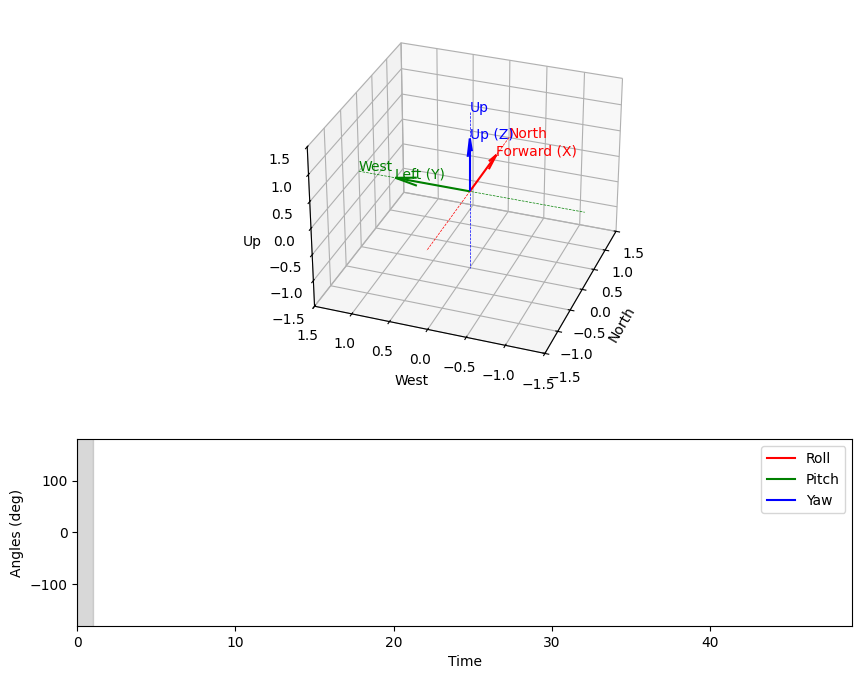

In [ ]:
# prompt: Why is the above code not outputting a video here in COLAB?

from IPython.display import HTML
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np

# ... (Your existing code for functions and data) ...

# Function to convert animation to video (replace with your actual implementation)
def anim_to_vid(ani, filename, fps=15):
    # This is a placeholder.  Replace this with actual code to save your animation.
    #  FFMpeg is needed for this.
    # The user needs to install it manually.
    Writer = animation.FFMpegWriter(fps=fps)
    ani.save(filename, writer=Writer)
    print(f"Animation saved as {filename}")  # Confirmation message
    return ani # Return the animation object


# Example usage (call your animate function here)
# For example, for animate_imu_data3:
trajectory_vid_fname = 'example_trajectory_vid.mp4'
ani2 = animate_imu_data3(imu_data, timestamps)
ani2 = anim_to_vid(ani2, trajectory_vid_fname) # Save as mp4

# Display the HTML representation of the animation
HTML(ani2.to_jshtml())

Upload files to google drive so they can be downloaded and played easily

In [ ]:
a = upload_file_to_drive_get_URL(full_nwu_vid_fname);
b = upload_file_to_drive_get_URL(stepbystep_nwu_vid_fname);
c = upload_file_to_drive_get_URL(flu_axis_convention_fname);
d = upload_file_to_drive_get_URL(nwu_axis_convention_fname);
e = upload_file_to_drive_get_URL(trajectory_vid_fname);

print("full_nwu_anim = '{}'\n\
stepbystep_nwu_anim = '{}'\n\
flu_axis_convention = '{}'\n\
nwu_axis_convention = '{}'\n\
imu_example = '{}'".format(
    a,b,c,d,e));

Load and prepare to play video files using moviepy

In [ ]:
from IPython.display import HTML
full_nwu_anim = a; #'https://drive.google.com/uc?id=1mTF5cB7mFuQ-MH6vC9xGO2610LNu9n6l'
stepbystep_nwu_anim = b; #'https://drive.google.com/uc?id=1FBAA6M33byLMCyCJWmp01C5kCDLOKE47'
flu_axis_convention = c; #'https://drive.google.com/uc?id=1MoDt6a-vCz5pEVA2VkJctoTbK5GFEtW7'
nwu_axis_convention = d; #'https://drive.google.com/uc?id=1RoQt6hQ15dWr-f7NGcF7qm11p1K63VyN'
imu_example = e; #'https://drive.google.com/uc?id=1wzTLOb9obikQmbKz38E3T_yTHCqkFsLY'
import gdown

fluconvfname = 'flu_conv.png'
nwuconvfname = 'nwu_conv.png'
fullfname = 'full.mp4'
stepbystepfname = 'stepbystep.mp4'
imu_ex_fname = 'imu_example.mp4'

gdown.download(full_nwu_anim, fullfname, quiet=False);
gdown.download(stepbystep_nwu_anim, stepbystepfname, quiet=False);
gdown.download(flu_axis_convention, fluconvfname, quiet=False);
gdown.download(nwu_axis_convention, nwuconvfname, quiet=False);
gdown.download(imu_example, imu_ex_fname, quiet=False);

!pip install moviepy
import moviepy.editor

In [ ]:
## Helper functions
## You have two options for uploading your data:
## 1) Upload data locally to this COLAB notebook instance (as a folder). In this case you will need to re-upload each time you leave/restart the instance.
## 2) Specify a "group" (A, B, C, etc.) URL from my server where I have uploaded the data. It will fetch it.

### (Eyetracker links and info)

A post with links to videos/slides about setting up eyelink: https://www.sr-research.com/support/showthread.php?tid=29&pid=28#pid28

Eyelink setup (remote head-free desktop): https://www.youtube.com/watch?v=l83byOG7Glw&list=PLOdF-B36TwspxRQeam0u5Yd29wOjUWcel&index=2

Arm mount: https://www.youtube.com/watch?v=D6WfJLe3NjY&list=PLOdF-B36TwspxRQeam0u5Yd29wOjUWcel&index=9

# Eye tracking analysis steps

Analysis of eye tracking data is similar no matter what eye tracker is used. Some eye trackers automatically perform some steps (e.g. blink removal). Sometimes, the eye tracker's methods are not accurate or we want to use a different method, and so we may use different algorithms to remove blinks, calibrate to stimulus display, or detect eye movement/fixation events.

1. Preprocess the data (Smoothing, removing errors)

2. Convert the coordinates and units into a common convention (i.e. positive Y mean "up", units are degrees visual angle).

3. Remove blinks and other bad data.

4. Combine left/right eye data into "binocular gaze".

5. Identify "events" (saccades, fixations).


You can now visualize your data and compute statistics of the physiological properties of the eye movements.

# EYELINK 1000(+) Data:
# Saccade, Smooth Pursuit, OKR, Vergence data

---
## Data Explanation

### 1: Gaze Data

Gaze data is collected via the Eyelink 1000+ remote VOG eye tracker (SR Research, Canada).

The EYELINK 1000+ (and EYELINK 1000) saves gaze data in EDF files. These are specialized binary files with a header are indicating EYELINK settings, a calibration section, and then a long list of three types of content:

1.   Samples
2.   Events
3.   Messages

*Samples* are basic CSV-like columnar data, with each sample row containing a value for each column. Columns include e.g. timestamp (in integer milliseconds), left eye gaze, right eye gaze, left eye pupil size, et cetera. The columns available will depend upon the settings (which eyes are tracked, etc.).

*Events* are blinks, saccades, and other gaze-related events. An event is likewise a CSV-like columnar record, containing timestamp, but with different numbers of columns depending on type. E.g. SSACC is start of saccade, and has just eye and time of start. ESACC is end of saccade, and has eye, start time, end time, start/end positions, and e.g. average/max velocities.

*Messages* are user-generated items for logging and synchronization purposes. They include a timestamp, and then the contents of the message (which has a maximum size in bytes). I have provided library functions which produce specially formatted messages to represent some important aspects of displaying stimuli and running gaze experiments (i.e. start of video trial, end of video trial, size of viewing area, size of video, etc.).

## EDF files contain mixture of samples, messages, and events in proprietary binary format.

You can extract them to ascii (text) format using SR Research's edf2asc program. This requires installing their software library. The libedf library is a proprietary C library, so you can not compile it yourself. They provide some access interface for EDF files in edf.h. A python wraper (pyedfread, https://github.com/s-ccs/pyedfread) converts EDF files to pandas dataframes. However, the python package requires the libedf headers (edf.h) and compiled binaries to be installed.

This is not simple to do on any machine, so all EYELINK data will in principle be provided as CSV files.

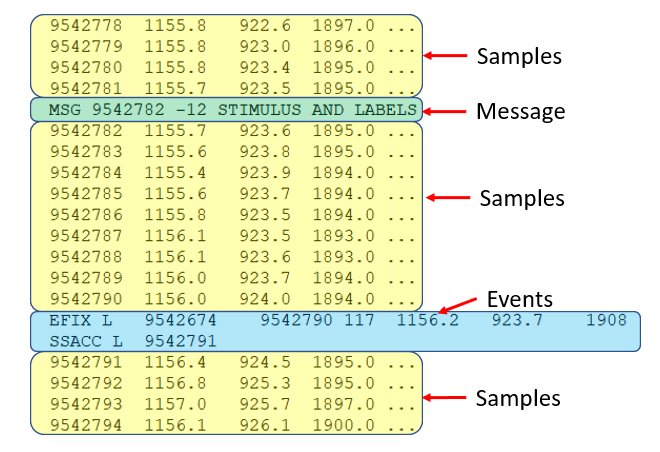

## Binocular tracking: separate gx_left and gx_right

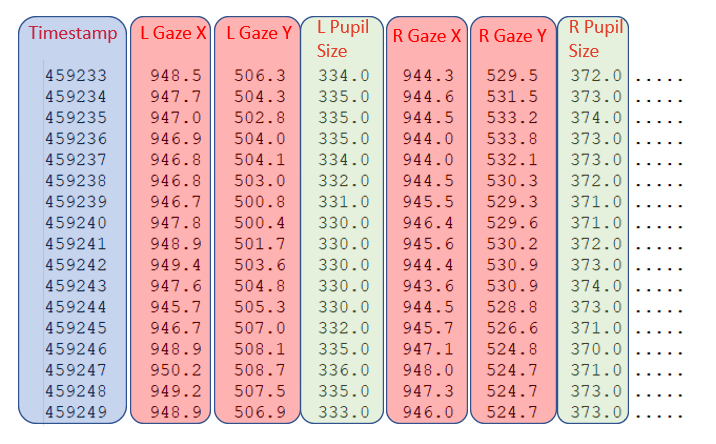

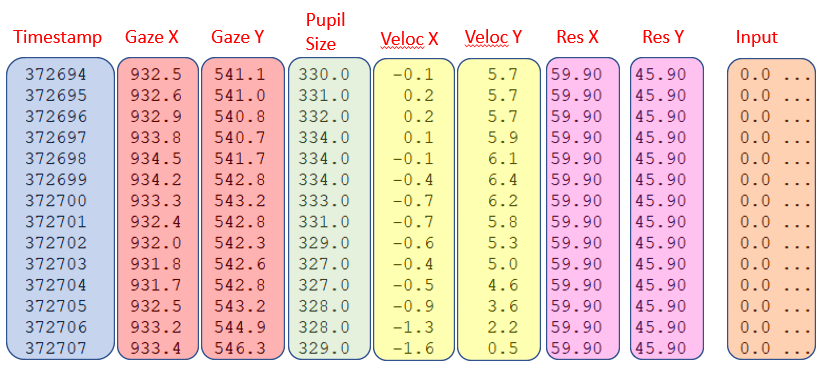

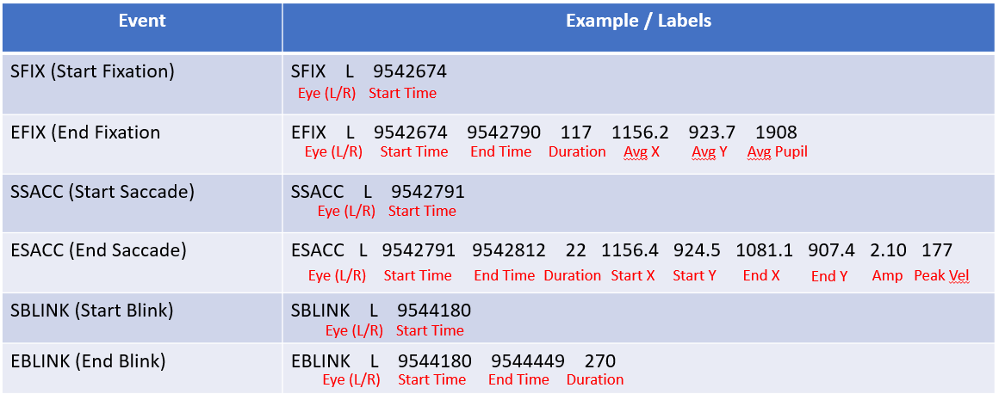

EDF files include raw pupil ellipse center coordinates px and py (in the eye camera, presumably relative to the CR glint). EDF file also may include calibrated gaze-on-screen (gx, gy), and head-referenced eye angle (hx, hy).

The units of gx and gy are determined at eyelink start time by eyelink parameters screen_dimension and physical_dimension. The calibration estimates a mapping from eye camera coordinates to calibration space (i.e. screen) coordinates, and writes those values as gx and gy. You can also make your own calibration by having the subject look at known locations, and mapping px/py to that space (usually using a 2nd order polynomial).

The EDF file additionally can provide head referenced (href, hx_left, hy_left) eye positions, which are eye *angles* (relative to an imaginary, unmoving head, in the case head-fixed mode).

## EYELINK practice: Basic plotting

We will start by loading some samples recorded by EYELINK (as a CSV file converted by pyedfread).

We will visualize a short section of it, and you will practice some analysis methods.

This is a file collected on Daiki watching some videos.

In [ ]:
import os;

datapath = '/content/drive/MyDrive/RTE_experiments/results/eyetracker_data/bigsmall/eyelink_data/';
filebase = 'PYFREE_daiki_controlbig1_endrec_start_2024-08-28-18-28-02_end_2024-08-28-18-33-16.edf';
samppath = os.path.join(datapath, filebase + ".samps.csv")
evpath = os.path.join(datapath, filebase + ".events.csv")
msgpath = os.path.join(datapath, filebase + ".msgs.csv")

from google.colab import drive
drive.mount('/content/drive', force_remount=True)
#from google.colab import auth
#auth.authenticate_user()

import pandas as pd;

sampdf = pd.read_csv(samppath)
evdf = pd.read_csv(evpath)
msgdf = pd.read_csv(msgpath)

Mounted at /content/drive


Now, sampdf, evdf, and msgdf are pandas DFs with our data in them.

In [ ]:
sampdf

,time,px_left,px_right,py_left,py_right,hx_left,hx_right,hy_left,hy_right,pa_left,...,fgyvel,fhxyvel,fhyvel,frxyvel,fryvel,flags,input,buttons,htype,errors
0,860149.0,-3287.0,-4122.0,-5268.0,-5605.0,16.0,24.0,-191.0,-106.0,1466.0,...,100000000.0,100000000.0,100000000.0,100000000.0,100000000.0,65473.0,127.0,0.0,-32768.0,0.0
1,860150.0,-3287.0,-4123.0,-5266.0,-5604.0,17.0,23.0,-188.0,-105.0,1467.0,...,100000000.0,100000000.0,100000000.0,100000000.0,100000000.0,57281.0,127.0,0.0,-32768.0,0.0
2,860151.0,-3287.0,-4123.0,-5263.0,-5605.0,17.0,22.0,-184.0,-107.0,1468.0,...,100000000.0,100000000.0,100000000.0,100000000.0,100000000.0,57281.0,127.0,0.0,-32768.0,0.0
3,860152.0,-3286.0,-4124.0,-5263.0,-5607.0,17.0,22.0,-183.0,-109.0,1469.0,...,100000000.0,100000000.0,100000000.0,100000000.0,100000000.0,57281.0,127.0,0.0,-32768.0,0.0
4,860153.0,-3286.0,-4124.0,-5262.0,-5609.0,18.0,21.0,-182.0,-112.0,1469.0,...,100000000.0,100000000.0,100000000.0,100000000.0,100000000.0,57281.0,127.0,0.0,-32768.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
336852,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
336853,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
336854,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
336855,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
evdf

,time,type,start,end,hstx,hsty,gstx,gsty,sta,henx,...,pvel,svel,evel,supd_x,eupd_x,eye,buttons,message,blink,trial
0,0,fixation,860156,860732,14.0,-188.0,527.200012,420.000000,1470.0,-19.0,...,31.400000,3.300000,31.400000,41.599998,41.700001,0,0,NaN,False,-1
1,0,fixation,860156,860734,22.0,-112.0,528.500000,432.000000,1454.0,-74.0,...,27.500000,2.400000,10.500000,41.599998,41.700001,1,0,NaN,False,-1
2,0,saccade,860733,860887,-9.0,-284.0,523.400024,404.700012,0.0,-13.0,...,1217.199951,32.900002,58.299999,41.700001,41.900002,0,0,NaN,True,-1
3,0,saccade,860735,860923,-73.0,-115.0,513.299988,431.500000,0.0,51.0,...,1047.599976,10.300000,21.900000,41.700001,41.700001,1,0,NaN,False,-1
4,0,fixation,860924,861088,46.0,-549.0,532.400024,362.399994,1742.0,54.0,...,60.900002,21.400000,25.100000,41.700001,41.700001,1,0,NaN,False,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2367,0,fixation,1172900,1173324,1671.0,3474.0,791.200012,1003.400024,1449.0,1700.0,...,46.099998,25.299999,44.000000,43.200001,42.900002,0,0,NaN,True,-1
2368,0,saccade,1173325,1173614,1705.0,2847.0,796.500000,903.500000,0.0,1440.0,...,3270.000000,45.400002,92.000000,42.900002,42.099998,0,0,NaN,True,-1
2369,0,fixation,1173615,1173769,1429.0,1059.0,752.599976,618.700012,875.0,1406.0,...,84.099998,84.099998,38.599998,42.099998,42.000000,0,0,NaN,False,-1
2370,0,saccade,1172853,1173812,3179.0,2854.0,1031.300049,904.500000,0.0,5195.0,...,983.000000,19.200001,951.000000,44.400002,47.299999,1,0,NaN,True,-1


In [ ]:
msgdf

,time,trial,message
0,860148,-1,RECCFG CR 1000 2 1 LR
1,860148,-1,ELCLCFG BTABLER
2,860148,-1,GAZE_COORDS 0.00 0.00 1050.00 900.00
3,860148,-1,THRESHOLDS L 115 243 R 110 233
4,860148,-1,ELCL_WINDOW_SIZES 160 160 0 0
...,...,...,...
18034,1169597,-1,VFR VID=clip_0000275773.mp4 OPAC=1.00 BGRGB=0....
18035,1169615,-1,VFR VID=clip_0000275773.mp4 OPAC=1.00 BGRGB=0....
18036,1169615,-1,VID E clip_0000275773.mp4 T=369.829304
18037,1172616,-1,BLK E FREE_VIEWING T=372.831274


The weird zero times at the end is worriesome, indicating maybe some kind of corruption or error. We'll ignore that for now.

Index(['time', 'px_left', 'px_right', 'py_left', 'py_right', 'hx_left',
       'hx_right', 'hy_left', 'hy_right', 'pa_left', 'pa_right', 'gx_left',
       'gx_right', 'gy_left', 'gy_right', 'rx', 'ry', 'gxvel_left',
       'gxvel_right', 'gyvel_left', 'gyvel_right', 'hxvel_left', 'hxvel_right',
       'hyvel_left', 'hyvel_right', 'rxvel_left', 'rxvel_right', 'ryvel_left',
       'ryvel_right', 'fgxvel', 'fgyvel', 'fhxyvel', 'fhyvel', 'frxyvel',
       'fryvel', 'flags', 'input', 'buttons', 'htype', 'errors'],
      dtype='object')


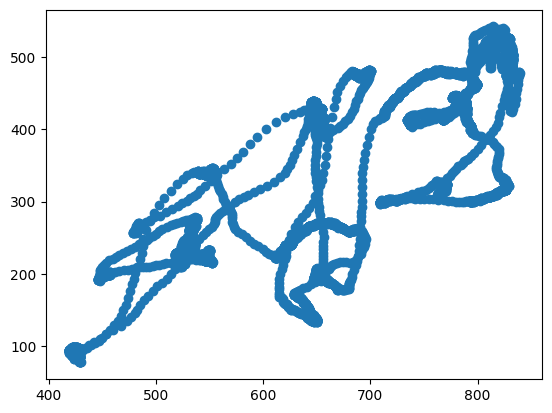

In [ ]:
import matplotlib.pyplot as plt

print(sampdf.columns)
sampdf = sampdf[ sampdf.time > 0 ].copy();
sampdf['t0s'] = 1e-3 * (sampdf.time - sampdf.time.min());
st=100
en=110
somedata = sampdf[ (sampdf.t0s >= st) & (sampdf.t0s < en)].copy();

plt.scatter(somedata.gx_left, somedata.gy_left);



This shows a "trace" of the eye in whatever space units gx and gy are in (they are viewbox "pixels"). This shows 20 seconds of data (from 100 seconds in to 120 seconds in).

Now lets show them as position over time. We can only show 2d, so we separate gx and gy.

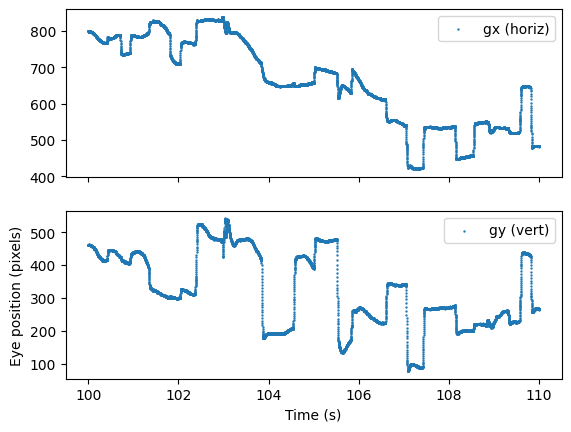

In [ ]:
plt.close();

fig, ax = plt.subplots(2, 1, sharex=True);
#s just sets the size of each scatter "dot"
ax[0].scatter(somedata.t0s, somedata.gx_left, s=0.5, label="gx (horiz)");
ax[1].scatter(somedata.t0s, somedata.gy_left, s=0.5, label="gy (vert)");
ax[0].legend();
ax[1].legend();
plt.xlabel("Time (s)");
plt.ylabel("Eye position (pixels)");

The quick jumps represent "saccades", i.e. quick looks from one location to another. Let's extract those using velocity.

The problem is, these are pixels, and we don't know what a normal physiological speed is for eye movements in this pixel space. We need to know how big a pixel is to know how fast the eyes are moving, to detect which movements are "fast".

This information was stored in "messages" by my stimulus control software (or as an experimenter, you should note it down).

In [ ]:
vboxmsgs = msgdf[ msgdf.message.str.contains('VB') ];

boxmsg = vboxmsgs[ vboxmsgs.message.str.contains('WPX')].iloc[0].message;
distmsg = vboxmsgs[ vboxmsgs.message.str.contains('DM')].iloc[0].message;
vboxmsgs

,time,trial,message
13,860194,-1,VB CX=0.000 CY=0.000 WPX=1050 HPX=900
14,860194,-1,VB DM=0.7000 PPM=3412.9693 TARGPX=-01 TARGDVA=...


DM here is distance screen to eye in meters. PPM is pixels per meter of the monitor. VB (viewbox) is the location and size of the viewbox in native pixels, with (0,0) being the center of the screen. This is irrelevant though, as the gaze calibration occurs only within the VBOX, so all gx/gy coordinates will be in that space. We see it has width 1050 and height 900.

Eyelink coordinates are set to use top-left as (0,0), thus y-positive is DOWN. We will have to flip our Y coordinates.

We can compute gaze angle from this information. Although resolution (in pixels per degree visual angle) will not be constant at different gaze eccentricities, the tangent function is nearly linear within the first 10-15 degrees around zero. Thus, we can linearly multiply by a constant (dva_per_pix) to get a good estimate. To get dva_per_pix we will simply estimate the angle subtended by a single pixel (of size 1/PPM meters) at distance 0.7 meters.

In [ ]:
import numpy as np

msg = distmsg;

vbdict = { a.split('=')[0]:a.split('=')[1] for a in msg.split(' ')[1:]};
print(vbdict);
DM = float(vbdict['DM']);
PPM = float(vbdict['PPM']);

dva_per_pix = np.degrees(np.arctan2(1/PPM, DM));
print(f"dva_per_pix = {dva_per_pix}");

msg = boxmsg;
vbwiddict = { a.split('=')[0]:a.split('=')[1] for a in msg.split(' ')[1:]};
print(vbwiddict)
#I know it was roughly 25-30 dva wide, so lets check that multiplying this by the width of 1050 pixels gives 25-30 dva.
WPX = float(vbwiddict['WPX']);
HPX = float(vbwiddict['HPX']);
print("Should be about 25 degrees:", dva_per_pix * WPX)

{'DM': '0.7000', 'PPM': '3412.9693', 'TARGPX': '-01', 'TARGDVA': '25.0000', 'TARGM': '-1.0000'}
dva_per_pix = 0.023982374763803892
{'CX': '0.000', 'CY': '0.000', 'WPX': '1050', 'HPX': '900'}
Should be about 25 degrees: 25.181493501994087


Now we can convert our pixels to degrees. We simply multiply by dva_per_px.

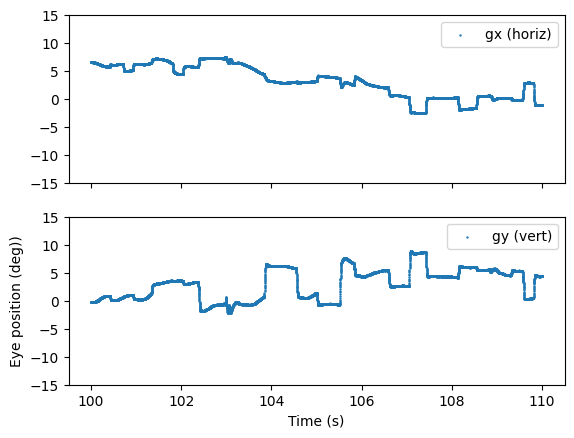

In [ ]:
#REV: just renaming some things and scaling to dva to make easier to plot.
# we will also center them to center of vbox first.
# We will also "flip" to make y point up.
FLIPY = -1;
somedata = somedata.copy(); #somedata was a slice (100-120 sec). This just makes it copy it to own memory segment...
somedata['x'] = (somedata.gx_left-WPX/2) * dva_per_pix;
somedata['y'] = FLIPY * (somedata.gy_left-HPX/2) * dva_per_pix;
somedata['t'] = somedata.t0s;

# Plot again.
plt.close();

fig, ax = plt.subplots(2, 1, sharex=True);
#s just sets the size of each scatter "dot"
ax[0].scatter(somedata.t, somedata.x, s=0.5, label="gx (horiz)");
ax[1].scatter(somedata.t, somedata.y, s=0.5, label="gy (vert)");
ax[0].legend();
ax[1].legend();
ax[0].set_ylim([-15,15]);
ax[1].set_ylim([-15,15]);
plt.xlabel("Time (s)");
plt.ylabel("Eye position (deg))");

Now let's compute velocity and acceleration...

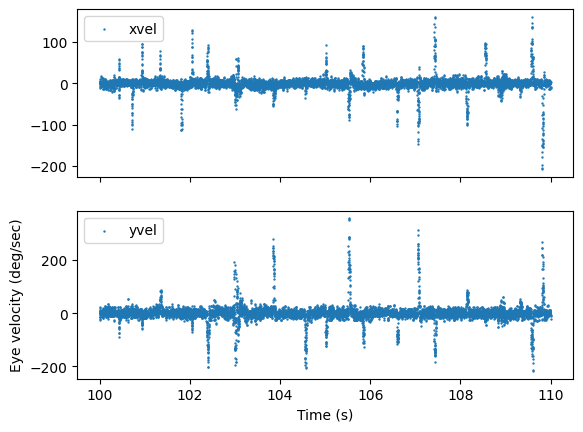

In [ ]:
somedata['dt'] = somedata.t.diff();
somedata['dx'] = somedata.x.diff();
somedata['dy'] = somedata.y.diff();
somedata['vx'] = somedata.dx/somedata.dt;
somedata['vy'] = somedata.dy/somedata.dt;

fig, ax = plt.subplots(2, 1, sharex=True)
ax[0].scatter(somedata.t, somedata.vx, label='xvel', s=0.5);
ax[1].scatter(somedata.t, somedata.vy, label='yvel', s=0.5);
ax[0].legend();
ax[1].legend();
plt.xlabel("Time (s)");
plt.ylabel("Eye velocity (deg/sec)");

We can clearly see some "upshoots" away (or down from) the mean. At the time of saccades! Let's ignore the directions and just compute total velocity.

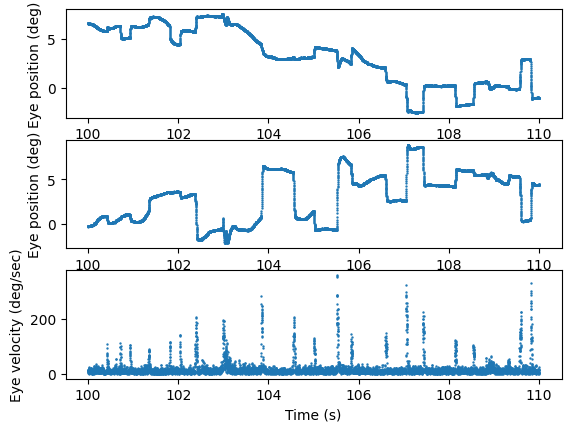

In [ ]:
somedata['vxy'] = np.sqrt(somedata.dx**2 + somedata.dy**2) / somedata.dt;

fig, ax = plt.subplots(3, 1);
ax[0].scatter(somedata.t, somedata.x, s=0.5);
ax[1].scatter(somedata.t, somedata.y, s=0.5);
ax[2].scatter(somedata.t, somedata.vxy, s=0.5);
plt.xlabel("Time (s)");
ax[0].set_ylabel("Eye position (deg)");
ax[1].set_ylabel("Eye position (deg)");
ax[2].set_ylabel("Eye velocity (deg/sec)");

Our goal is to detect those events. The simplest idea will just filter by time points when eye velocity is higher than some threshold. Of course we should do other preprocessing/filtering first to smooth things out, remove outliers, et cetera. We'll ignore that for now.

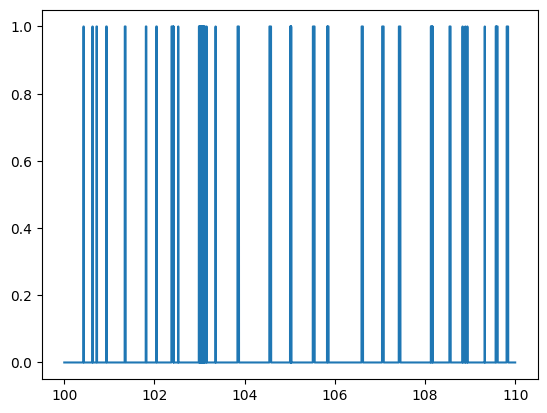

In [ ]:
threshdvapersec = 50; #I just chose this by looking at data. Really we should use a smart way that takes into account the local noise in the signal.

issacc = somedata.vxy > threshdvapersec;
somedata['issacc'] = issacc;

plt.close();
plt.plot(somedata.t, issacc);

It looks like there is one section around 103 seconds that is possibly a blink or error. Other than that it looks OK...

In [ ]:
## These are some helper functions to do RLE (run length encoding)

def rle(x, withnan=True):
    """Find runs of consecutive items in an array."""
    """REV: modified for NAN/INF"""

    # ensure array
    x = np.asanyarray(x)
    if(x.ndim != 1):
        raise ValueError('only 1D array supported')
    n = x.shape[0]

    # handle empty array
    if(0 == n):
        return np.array([]), np.array([]), np.array([])
    else:
        # find run starts
        loc_run_start = np.empty(n, dtype=bool)
        loc_run_start[0] = True
        np.not_equal(x[:-1], x[1:], out=loc_run_start[1:])
        run_starts = np.nonzero(loc_run_start)[0]

        # find run values
        run_values = x[loc_run_start]

        # find run lengths
        run_lengths = np.diff(np.append(run_starts, n))

        return run_values, run_starts, run_lengths

    print("ERROR: RLE (should never reach end...)");
    exit(1);
    return;


#REV: build array X from rle values
def inverse_rle(run_values, run_starts, run_lengths):
    totallen=np.sum(run_lengths); #REV: must be list?
    x=np.zeros(totallen, dtype=run_values.dtype); #REV: will make false if bool
    for val, st, size in zip(run_values, run_starts, run_lengths):
        x[st:st+size] = val; #REV: e.g. if 0 and 10, OK.
        pass;
    return x;

#REV: creates a RLE of True/False for condition (val==val). I.e. for input x, creates boolean array x==val, then
# runs RLE on that, then otuputs a df, with some useful columns, possibly related to time (t)
def cond_rle_df( x, val, t=None ):
    if( t is None ):
        t = range(0, len(x));
        pass;
    if( len(t) != len(x) ):
        raise Exception("Time length is {}, neq X length {} (events_over_thresh)".format(len(t), len(x)));

    if( len(x) < 1 ):
        raise Exception("Input x len is <1");

    boolarr = (x==val);
    vals, starts, lens = rle(boolarr);

    alist=list();
    #REV: -1 as end is the index AFTER it.

    t = np.array(t); #REV: remove weird indexing shit? Assume sorting is identical.
    for v, s, l in zip(vals, starts, lens):
        d = dict( v=v,
                  sidx=s,
                  lidx=l,
                  eidx=s+l,
                  st=t[s],
                  et=t[s+l-1],
                  lent=(t[s+l-1]-t[s])
                 );
        alist.append(d);
        pass;

    evdf = pd.DataFrame(alist);
    return evdf;

In [ ]:
saccdf = cond_rle_df(somedata.issacc, 1, somedata.t)
saccdf = saccdf[saccdf.v==True]
saccdf

,v,sidx,lidx,eidx,st,et,lent
1,True,425,7,432,100.425,100.431,0.006
3,True,626,2,628,100.626,100.627,0.001
5,True,713,12,725,100.713,100.724,0.011
7,True,929,13,942,100.929,100.941,0.012
9,True,1340,20,1360,101.340,101.359,0.019
11,True,1807,14,1821,101.807,101.820,0.013
13,True,2039,13,2052,102.039,102.051,0.012
15,True,2376,44,2420,102.376,102.419,0.043
17,True,2422,1,2423,102.422,102.422,0.000
19,True,2526,2,2528,102.526,102.527,0.001


I will exclude unrealistically short saccades.

In [ ]:
saccdf = saccdf[ saccdf.lent > 0.008 ].reset_index(drop=True)
saccdf

,v,sidx,lidx,eidx,st,et,lent
0,True,713,12,725,100.713,100.724,0.011
1,True,929,13,942,100.929,100.941,0.012
2,True,1340,20,1360,101.340,101.359,0.019
3,True,1807,14,1821,101.807,101.820,0.013
4,True,2039,13,2052,102.039,102.051,0.012
5,True,2376,44,2420,102.376,102.419,0.043
6,True,2994,10,3004,102.994,103.003,0.009
7,True,3016,11,3027,103.016,103.026,0.010
8,True,3044,10,3054,103.044,103.053,0.009
9,True,3841,32,3873,103.841,103.872,0.031


Let's see how it looks with a quick plot with some spans.

In [ ]:
def draw_saccs(ax, saccs):
    for i,s in saccs.iterrows():
        ax.axvspan(
            s['st'],
            s['et'],
            alpha=0.2,
            color='gray'
        );
        pass;
    return ax;

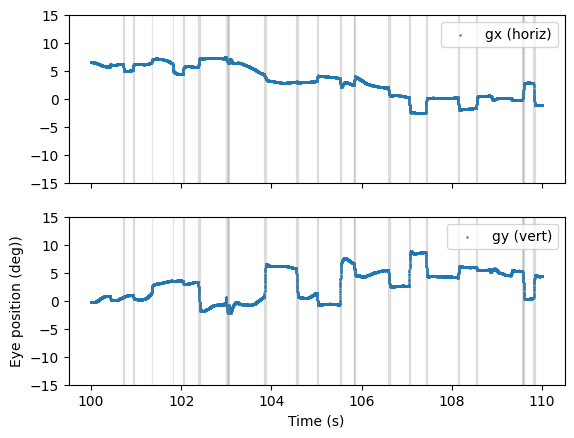

In [ ]:
fig, ax = plt.subplots(2, 1, sharex=True);
#s just sets the size of each scatter "dot"
ax[0].scatter(somedata.t, somedata.x, s=0.5, label="gx (horiz)");
ax[1].scatter(somedata.t, somedata.y, s=0.5, label="gy (vert)");
draw_saccs(ax[0], saccdf);
draw_saccs(ax[1], saccdf)
ax[0].legend();
ax[1].legend();
ax[0].set_ylim([-15,15]);
ax[1].set_ylim([-15,15]);
plt.xlabel("Time (s)");
plt.ylabel("Eye position (deg))");

### TASK: Plot saccades

That looks pretty good!

Next, we want to get the starting/ending positions of the saccades and determine their directions and magnitudes (sizes).

Go ahead and do that now.

**HINT: get somedata.x and somedata.y at somedata[somedata.t==st] and somedata[somedata.t==et] for every (st, et) pair in saccdf**

Then, compute the distance and direction between the starting and ending x and y positions.

Plot the directions and sizes as vectors.

Plot the raw samples in each interval on a non-centered and a centered plot. What is the eye doing during saccades? Are the movements perfectly straight?

### TASK: Extract saccades by ACCELERATION (not velocity)

We used an acceleration threshold to extract saccades. It is very brittle, if there was an erraneous measurement in the middle of a saccade with low velocity it would separate it into two saccades. So, that requires better filtering.

However, another issue is that velocity is not always reliable, especially for small saccades made during VOR (for example).

A more reliable method would be to compare velocity against the local velocities in time. But, that is basically acceleration.

We can compute saccades via acceleration, since saccades are made of an acceleration, and then a deceleration.

I recommend you compute axy (total acceleration), and identify periods when it is above some threshold (300 deg/sec/sec?) as the start of saccade, and below some threshold (-300) as the end of a saccade. Of course this is based on what we know of the physiology of saccades -- they are ballistic.

Try it yourself.

# Physiology Lab 2024: VOR Data (Tobii G3)
---
## Data Explanation

### 1: Gaze Data

Gaze data is collected in both 2D image coordinates of the scene camera, with (0,0) being top-left of image, (1,1) being bottom-right of the image. The left and right eye 3D gaze direction vectors represent the direction each eye is pointing. Gaze in 3D Cartesian space is computed. It is a vector being where the subject is looking (including the distance to the target). This is estimaged by combining the left and right eye gaze directions to find the target of their vergence. The coordinate convention of the Tobii G3 data is originally WUN (West, Up, North), i.e. X is to the left (West), Y is up, Z points forward (North). We will convert this to a more common format later (WNU).


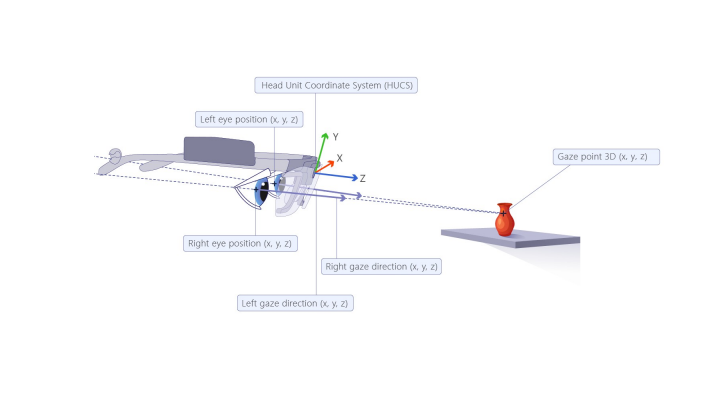

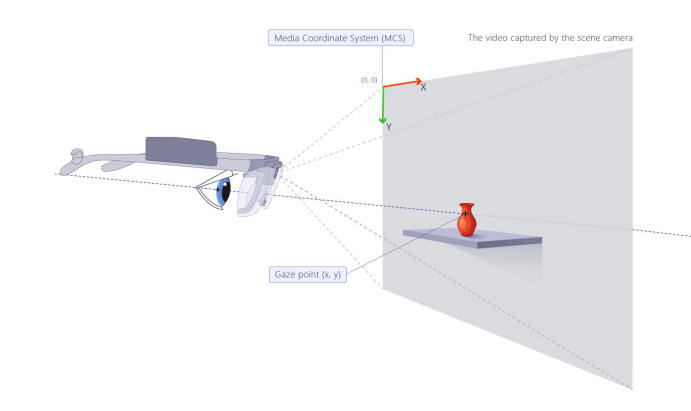



### 2: IMU (Head Movement) Data
Movement of the glasses (and thus head) is tracked by an inertial measurement unit (IMU). IMU includes three devices:

* accelerometer (m/s/s - converted to *g*) - *Acceleration* on the axis. In free-fall, one would feel zero acceleration. Standing on the ground on Earth, one feels a 9.8 m/s/s acceleration *UP* (due to normal force). In an elevator going up, one feels more than 9.8 m/s/s going up.
* gyroscope (deg/s) - Rotational *velocity* around axis.
* magnetometer (uT) - Strength of magnetic field on each axis. This should be maximized on each axis when pointing towards magnetic north (along Earth's magnetic field lines).

As with gaze, IMU are in the WUN convention.

### 4: Egocentric Video (Head-Mounted "Scene Camera")

The Tobii G3 records H264 25 fps 1920x1080 video from the egocentric "scene" camera mounted in the center of the head unit (i.e. the glasses). We have access to the camera model (intrinsic parameters) and datasheet, and from these we know the degrees of visual angle of the camera pixels.

### 3: Conversion to common WNU convention

I have converted gaze into 2D Euler angles representing yaw (horizontal rotation, around up/down axis) and pitch (vertical rotation, around left/right axis) pose relative to straight ahead (**not velocties!**), in in the NWU convention. The Tobii G3 eye tracking system does not measure the torsional (roll, around forwards/backwards axis) component of gaze.

I report Euler angles from here as yaw (horiz), pitch (verti), and roll (torsion), corresponding to respective rotation around NWU's Z, Y, and X axes.

I have furthermore provided an estimated absolute (compass) heading via integration of all three IMU sensors, using an AHRS (attitude and heading reference system) algorithm. In this case, I used the Madgwick algorithm (https://ahrs.readthedocs.io/en/latest/filters/madgwick.html). The data conversion and heading estimation required installation of C-language based python packages, which is not trivial to accomplish in a COLAB notebook. Thus, I performed the conversions using peyeutils (eyeutils), specifically "eyeutils/examples/imu/imu_from_tobiig3_recording". This script does several things:


1.   Loads the Tobii G3 data from the specified directory and automatically generates CSV files from the gzipped JSON files.
2.   Converts the tobii data to NWU convention and outputs new CSV files with those additional columns.
3.   Converts gaze to YPR (yaw, pitch, roll) format and saves CSV files with those additional columns.
4.   Uses the Madgwick filter (implemented by IMUFUSION, https://github.com/xioTechnologies/Fusion) to integrate magnetometer (if available), gyroscope, and accelerometer data into a pose estimate (i.e. pose/heading in terms of facing North, West, and Up). These use NWU convention and are represented as Euler (Brait-Tyler?) rotations about the N/W/U axes, representing Yaw, Pitch, and Roll.
5.   Merges the AHRS (attitude and heading reference system) head data with the gaze data into a single CSV file.
6.   Runs a quick-and-dirty acceleration-based algorithm to remove fast eye movements and saves those traces to new column variables. However, low sampling rate (100Hz) and high noise in Tobii g3 makes detection of fast eye movements difficult (especially small eye movements). These are not saved to CSV yet, just used for plotting and gain computation right now.
6.   Runs some low-pass filter (gaussian kernel convolutions) and makes some plots specific to the VOR physiology lab and timings of sub-experiments to compute VOR gain. These are hard-coded and not important at this point.

Note, gaze data is still eye-in-head (i.e. head-reference). Head data is head-in-world. It is possible to determine absolute compass direction of gaze by summing the head data with the gaze data.

## Axis Convention (NWU)

I use the NWU convention to represent both endogenous (self-relative) coordinates, as well as exogenous (external world) coordinates.

Endogenous (egocentric) coordinates represent rotations in head-space, e.g. rotations of gaze away from pointing straight ahead. We will use NWU convention, i.e. X is straight ahead ("forward"), Y is to the left, Z is up.

Exogenous (allocentric) coordinates represent rotations of the head in external space (we will use compass directions on Earth's surface, i.e. North, West, Up, as the axes).

When you are facing directly north with no roll, the endogenous and exogenous coordinates will be lined up.

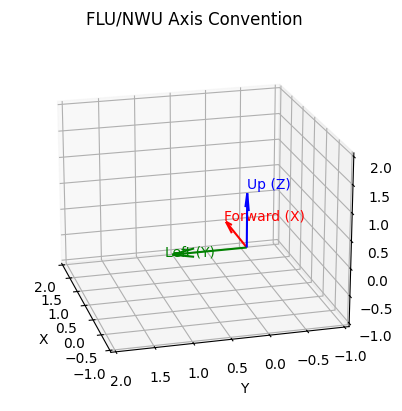

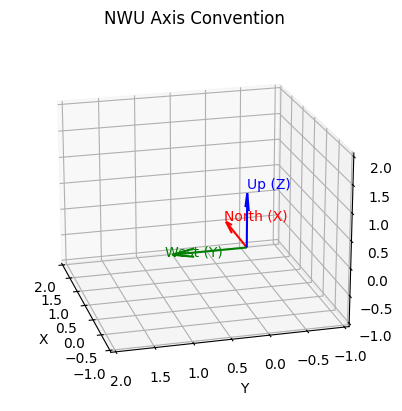

## Axis Rotations

Euler angles represented around an axis represent the amount of rotation around that axis, with positive being clockwise. The order of rotations is yaw-pitch-roll, i.e. Z-Y'-X'' order, with the primes Y' and X'' representing rotation around the co-rotating (self) axis, not the original axes.



You will perform several basic tasks, including:

1. Extracting and plotting sub-sections of data based on start/end times of an event.
2. Computing derived measurements (instantaneous velocity) via differentiation.
3. Computing reflex gain.
4. Observe properties of VOR with/without visual input.
5. Estimating reflex delay via (auto)correlation.

In general, to analyse an event (saccade, VOR, etc.), you require:

1. The data file source name.
2. The start/end times in seconds.

Then, to plot something as a timecourse, you need:

3. The signal(s) that you will plot (against time) and their labels.

I provide helper functions to facilitate extracting sub-dataframes based on start/end times and for plotting timecourses.

From a practical point of view, the most difficult part is how to get the data files into your notebook instance. In general, there are 3 ways:

1. Upload them each time to the instance and open them normally via python open() or wrappers such as pd.read_csv()
2. Access them automatically via URLs from some (public or authenticated) source outside of google drive.
3. Via google drive (with or without authentication).

For the case of this lab, data is not particularly private or sensitive under ethical guidelines. I will put it on a public (but unlisted) google drive link.

## Axis rotations

The following animations remind you of how rotation using Euler angles works. A single rotation axis is computed based on the Euler angles, and a rotation about that axis occurs. Our convention is that an Euler (Tait–Bryan) rotation of (X, Y, Z) is equivalent to a rotation in intrinsic coordinates around Z, then a rotation around Y' (Y axis that has rotated with us so far), and finally X'' (X axis that has rotated with us so far). These are also called "nautical heading" and can be referred to as Yaw, Pitch, and Roll (applied in that order).

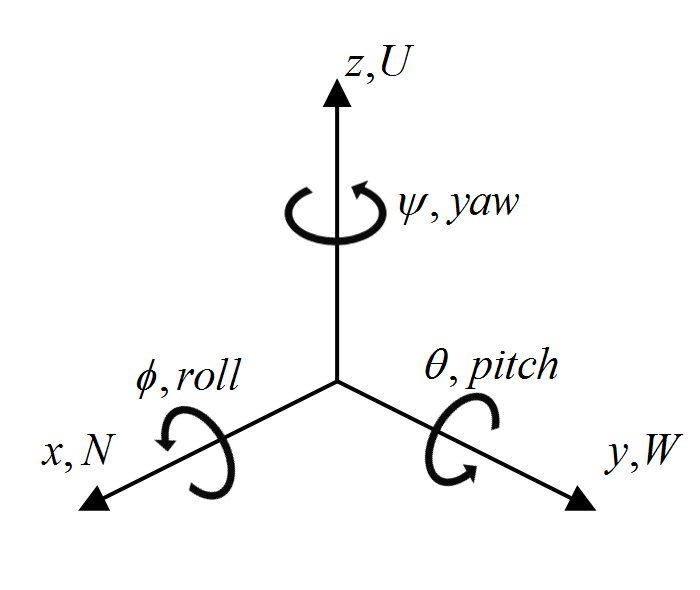

## Example Rotation (25, -45, -45) deg
See the following rotation (axis of rotation shown in black). "North" starts at (0,0,0) degrees and rotates to point afterwards at (25, -45, -45) degrees, i.e. halfway to right, halfway up, and with slight roll.

In [ ]:
moviepy.editor.ipython_display(fullfname)

## Rotation (25, -45, -45) step-by-step

This shows the order in which rotations are applied (Yaw-Pitch-Roll, i.e. Z-Y'-X'')

In [ ]:
moviepy.editor.ipython_display(stepbystepfname)

## Example of a timecourse of 3D rotation

In [ ]:
moviepy.editor.ipython_display(imu_ex_fname)

# Results
In this section, we will view the results of the multiple experiments one at a time. We are interested in several points, which differ depending on the example experiment. For some experiments, we wish to calculate saccade speed, for others drift speed, for others the correlation between head rotation and eye rotation, for still others, the number of eye movements per line of text during reading. These each require different time scales and different computations to quantify results programmatically. Thus, I offer the following helper functions:

1. Plot all time points in an experiment (optionally from a start/end offset) at a given timescale, and with given scales for each ordinate signal plotted. This will separate the data into multiple "pages" of plots.

## Data Access

Data access to files occurs via two functions. The purpose is due to different naming and timing conventions between eyelink data and tobii g3 data. I convert these to a common format before or after reading. For eyelink data, access can be done via times (date, hour, minute, second) based on filename and/or eyelink messages in data. Alternatively, file names can be copied/pasted, in which case they take precedent. A filename/data lookup function for eyelink data is presented, which selects the closest file with start time **equal to or after** the passed time.

# Experiment 1

# 1.1 Conjugate saccades

Instructions: Central fixation then right, up, left, down.

1.2